# <center><font color=black>Project</font> </center> 
# <center><font color=blue>PREDICTION OF BREAST CANCER USING MACHINE LEARNING</font> </center> 

In [1]:
print("Hello World")

Hello World


In [2]:
# Import packages
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
#plt.rcParams['figure.figsize'] = [8, 5]
import seaborn as sns

from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import accuracy_score, precision_score, recall_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

from sklearn import svm

from sklearn.linear_model import LogisticRegression

from sklearn.tree import DecisionTreeClassifier, export_text
from sklearn import metrics, tree
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier

/Users/srisairesu/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


In [3]:
# Import and code data
cancerData = pd.read_csv("WisconsinBreastCancerDatabase.csv")
cancerData

,ID,Diagnosis,Radius mean,Texture mean,Perimeter mean,Area mean,Smoothness mean,Compactness mean,Concavity mean,Concave points mean,...,Radius worst,Texture worst,Perimeter worst,Area worst,Smoothness worst,Compactness worst,Concavity worst,Concave points worst,Symmetry worst,Fractal dimension worst
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,...,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,926424,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,926682,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,926954,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,927241,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


## Data Description

1) ID number
2) Diagnosis (M = malignant, B = benign)

Ten real-valued features are computed for each cell nucleus:

	a) radius (mean of distances from center to points on the perimeter)
	b) texture (standard deviation of gray-scale values)
	c) perimeter
	d) area
	e) smoothness (local variation in radius lengths)
	f) compactness (perimeter^2 / area - 1.0)
	g) concavity (severity of concave portions of the contour)
	h) concave points (number of concave portions of the contour)
	i) symmetry 
	j) fractal dimension ("coastline approximation" - 1)

In [4]:
cancerData.describe()

,ID,Radius mean,Texture mean,Perimeter mean,Area mean,Smoothness mean,Compactness mean,Concavity mean,Concave points mean,Symmetry mean,...,Radius worst,Texture worst,Perimeter worst,Area worst,Smoothness worst,Compactness worst,Concavity worst,Concave points worst,Symmetry worst,Fractal dimension worst
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,3.037183e+07,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,1.250206e+08,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,8.670000e+03,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,8.692180e+05,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,9.060240e+05,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,8.813129e+06,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,9.113205e+08,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [5]:
cancerData.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   ID                       569 non-null    int64  
 1   Diagnosis                569 non-null    object 
 2   Radius mean              569 non-null    float64
 3   Texture mean             569 non-null    float64
 4   Perimeter mean           569 non-null    float64
 5   Area mean                569 non-null    float64
 6   Smoothness mean          569 non-null    float64
 7   Compactness mean         569 non-null    float64
 8   Concavity mean           569 non-null    float64
 9   Concave points mean      569 non-null    float64
 10  Symmetry mean            569 non-null    float64
 11  Fractal dimension mean   569 non-null    float64
 12  Radius se                569 non-null    float64
 13   texture se              569 non-null    float64
 14  Perimeter se             5

In [6]:
# Display a sample of the data
cancerData.sample(5, random_state=10)

,ID,Diagnosis,Radius mean,Texture mean,Perimeter mean,Area mean,Smoothness mean,Compactness mean,Concavity mean,Concave points mean,...,Radius worst,Texture worst,Perimeter worst,Area worst,Smoothness worst,Compactness worst,Concavity worst,Concave points worst,Symmetry worst,Fractal dimension worst
172,87164,M,15.460,11.89,102.50,736.9,0.12570,0.15550,0.203200,0.10970,...,18.790,17.04,125.00,1102.0,0.1531,0.35830,0.58300,0.18270,0.3216,0.10100
553,924342,B,9.333,21.94,59.01,264.0,0.09240,0.05605,0.039960,0.01282,...,9.845,25.05,62.86,295.8,0.1103,0.08298,0.07993,0.02564,0.2435,0.07393
374,9013005,B,13.690,16.07,87.84,579.1,0.08302,0.06374,0.025560,0.02031,...,14.840,20.21,99.16,670.6,0.1105,0.20960,0.13460,0.06987,0.3323,0.07701
370,9012315,M,16.350,23.29,109.00,840.4,0.09742,0.14970,0.181100,0.08773,...,19.380,31.03,129.30,1165.0,0.1415,0.46650,0.70870,0.22480,0.4824,0.09614
419,906290,B,11.160,21.41,70.95,380.3,0.10180,0.05978,0.008955,0.01076,...,12.360,28.92,79.26,458.0,0.1282,0.11080,0.03582,0.04306,0.2976,0.07123


In [7]:
cancerData.groupby(by=['Diagnosis']).mean()

,ID,Radius mean,Texture mean,Perimeter mean,Area mean,Smoothness mean,Compactness mean,Concavity mean,Concave points mean,Symmetry mean,...,Radius worst,Texture worst,Perimeter worst,Area worst,Smoothness worst,Compactness worst,Concavity worst,Concave points worst,Symmetry worst,Fractal dimension worst
Diagnosis,,,,,,,,,,,,,,,,,,,,,
B,2.654382e+07,12.146524,17.914762,78.075406,462.790196,0.092478,0.080085,0.046058,0.025717,0.174186,...,13.379801,23.515070,87.005938,558.899440,0.124959,0.182673,0.166238,0.074444,0.270246,0.079442
M,3.681805e+07,17.462830,21.604906,115.365377,978.376415,0.102898,0.145188,0.160775,0.087990,0.192909,...,21.134811,29.318208,141.370330,1422.286321,0.144845,0.374824,0.450606,0.182237,0.323468,0.091530


In [8]:
cancerData = cancerData.dropna()

In [9]:
#counting no.of null values in each column
cancerData.isna().sum()

ID                         0
Diagnosis                  0
Radius mean                0
Texture mean               0
Perimeter mean             0
Area mean                  0
Smoothness mean            0
Compactness mean           0
Concavity mean             0
Concave points mean        0
Symmetry mean              0
Fractal dimension mean     0
Radius se                  0
 texture se                0
Perimeter se               0
Area se                    0
Smoothness se              0
Compactness se             0
 Concavity se              0
Concave points se          0
Symmetry se                0
Fractal dimension se       0
Radius worst               0
Texture worst              0
Perimeter worst            0
Area worst                 0
Smoothness worst           0
Compactness worst          0
Concavity worst            0
Concave points worst       0
Symmetry worst             0
Fractal dimension worst    0
dtype: int64

In [10]:
cancerData = cancerData.replace(to_replace=["M", "B"], value=[int(1), int(0)])
cancerData

/var/folders/nh/rcjgvnd10bd5sl0svybz938w0000gn/T/ipykernel_9702/82720650.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  cancerData = cancerData.replace(to_replace=["M", "B"], value=[int(1), int(0)])


,ID,Diagnosis,Radius mean,Texture mean,Perimeter mean,Area mean,Smoothness mean,Compactness mean,Concavity mean,Concave points mean,...,Radius worst,Texture worst,Perimeter worst,Area worst,Smoothness worst,Compactness worst,Concavity worst,Concave points worst,Symmetry worst,Fractal dimension worst
0,842302,1,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,...,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,842517,1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,84300903,1,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,84348301,1,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,84358402,1,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,926424,1,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,926682,1,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,926954,1,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,927241,1,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


In [11]:
cancerData.describe()

,ID,Diagnosis,Radius mean,Texture mean,Perimeter mean,Area mean,Smoothness mean,Compactness mean,Concavity mean,Concave points mean,...,Radius worst,Texture worst,Perimeter worst,Area worst,Smoothness worst,Compactness worst,Concavity worst,Concave points worst,Symmetry worst,Fractal dimension worst
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,3.037183e+07,0.372583,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,1.250206e+08,0.483918,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,8.670000e+03,0.000000,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,8.692180e+05,0.000000,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,9.060240e+05,0.000000,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,8.813129e+06,1.000000,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,9.113205e+08,1.000000,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


## Performing exploratory data analysis

## Identify relationships between features

array([[<Axes: xlabel='ID', ylabel='ID'>,
        <Axes: xlabel='Diagnosis', ylabel='ID'>,
        <Axes: xlabel='Radius mean', ylabel='ID'>, ...,
        <Axes: xlabel='Concave points worst', ylabel='ID'>,
        <Axes: xlabel='Symmetry worst', ylabel='ID'>,
        <Axes: xlabel='Fractal dimension worst', ylabel='ID'>],
       [<Axes: xlabel='ID', ylabel='Diagnosis'>,
        <Axes: xlabel='Diagnosis', ylabel='Diagnosis'>,
        <Axes: xlabel='Radius mean', ylabel='Diagnosis'>, ...,
        <Axes: xlabel='Concave points worst', ylabel='Diagnosis'>,
        <Axes: xlabel='Symmetry worst', ylabel='Diagnosis'>,
        <Axes: xlabel='Fractal dimension worst', ylabel='Diagnosis'>],
       [<Axes: xlabel='ID', ylabel='Radius mean'>,
        <Axes: xlabel='Diagnosis', ylabel='Radius mean'>,
        <Axes: xlabel='Radius mean', ylabel='Radius mean'>, ...,
        <Axes: xlabel='Concave points worst', ylabel='Radius mean'>,
        <Axes: xlabel='Symmetry worst', ylabel='Radius mean'>,
  

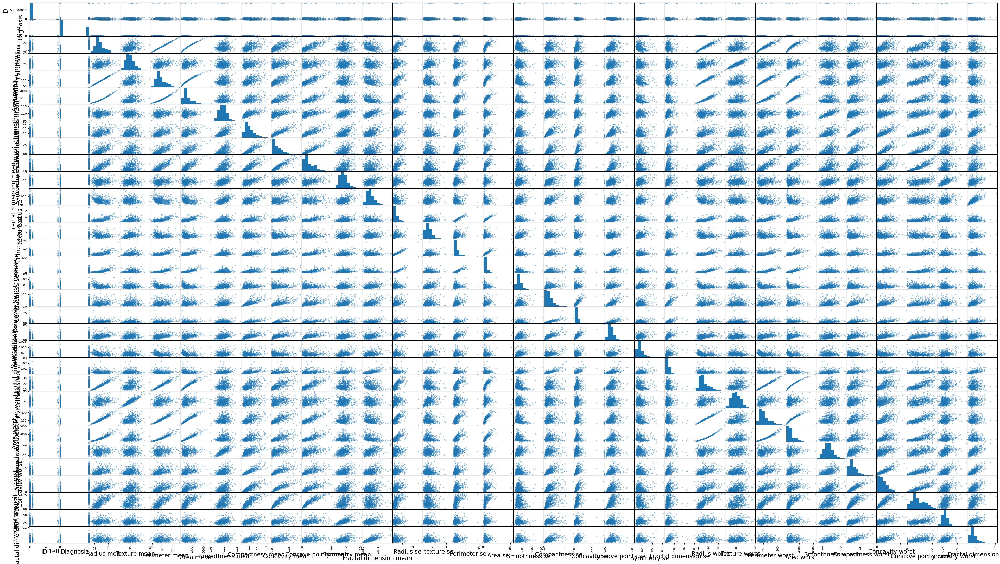

In [66]:
# Setting the figure dimensions to 48 by 27
#sns.set(rc={'figure.figsize': (48, 27)})  ## change later
#plt.figure(figsize=(48, 27))
pd.plotting.scatter_matrix(cancerData, figsize=(48, 27))

In [13]:
plt.rcParams.update({'font.size': 14})
p = sns.pairplot(cancerData, hue='Diagnosis', markers=['o', 's'])
plt.show()

/Users/srisairesu/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/srisairesu/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/srisairesu/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/srisairesu/anaconda3/lib/python3.11/site-packages/seaborn/_

/Users/srisairesu/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/srisairesu/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/Users/srisairesu/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/srisairesu/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping w

## Describe the shape of data

array([[<Axes: title={'center': 'ID'}>,
        <Axes: title={'center': 'Diagnosis'}>,
        <Axes: title={'center': 'Radius mean'}>,
        <Axes: title={'center': 'Texture mean'}>,
        <Axes: title={'center': 'Perimeter mean'}>,
        <Axes: title={'center': 'Area mean'}>],
       [<Axes: title={'center': 'Smoothness mean'}>,
        <Axes: title={'center': 'Compactness mean'}>,
        <Axes: title={'center': 'Concavity mean'}>,
        <Axes: title={'center': 'Concave points mean'}>,
        <Axes: title={'center': 'Symmetry mean'}>,
        <Axes: title={'center': 'Fractal dimension mean'}>],
       [<Axes: title={'center': 'Radius se'}>,
        <Axes: title={'center': ' texture se'}>,
        <Axes: title={'center': 'Perimeter se'}>,
        <Axes: title={'center': 'Area se'}>,
        <Axes: title={'center': 'Smoothness se'}>,
        <Axes: title={'center': 'Compactness se'}>],
       [<Axes: title={'center': ' Concavity se'}>,
        <Axes: title={'center': 'Concave

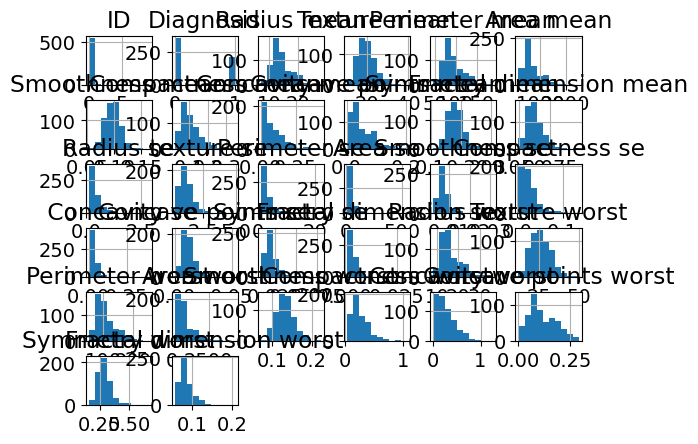

In [14]:
cancerData.hist()

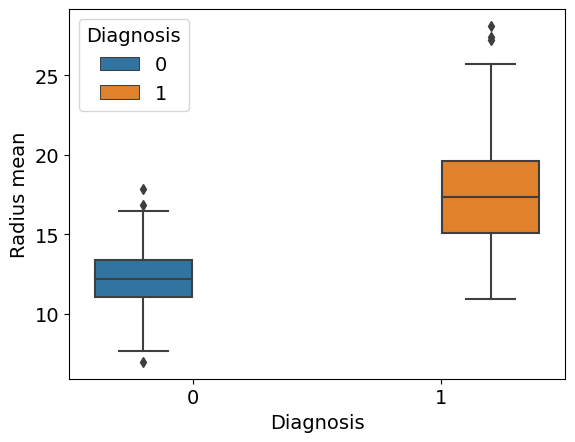

In [15]:
# Plot boxplot
p = sns.boxplot(data=cancerData, x="Diagnosis", y="Radius mean", hue="Diagnosis")
p.set_xlabel("Diagnosis", fontsize=14)
p.set_ylabel("Radius mean", fontsize=14)
plt.show()

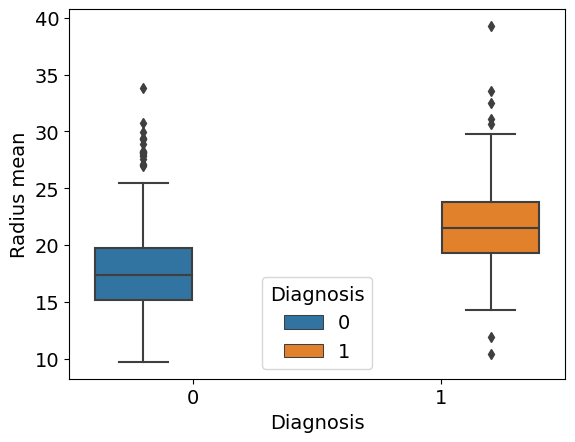

In [16]:
# Plot boxplot
p = sns.boxplot(data=cancerData, x="Diagnosis", y="Texture mean", hue="Diagnosis")
p.set_xlabel("Diagnosis", fontsize=14)
p.set_ylabel("Radius mean", fontsize=14)
plt.show()

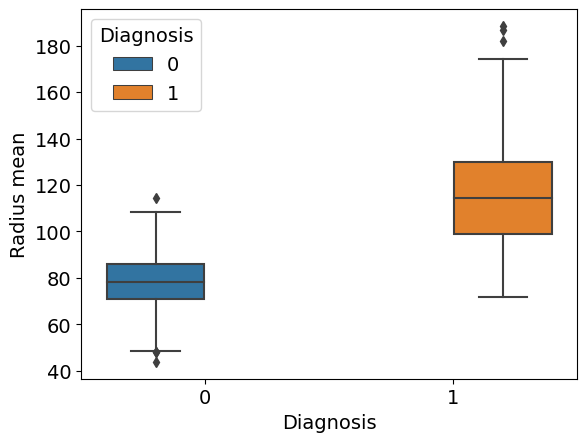

In [17]:
# Plot boxplot
p = sns.boxplot(data=cancerData, x="Diagnosis", y="Perimeter mean", hue="Diagnosis")
p.set_xlabel("Diagnosis", fontsize=14)
p.set_ylabel("Radius mean", fontsize=14)
plt.show()

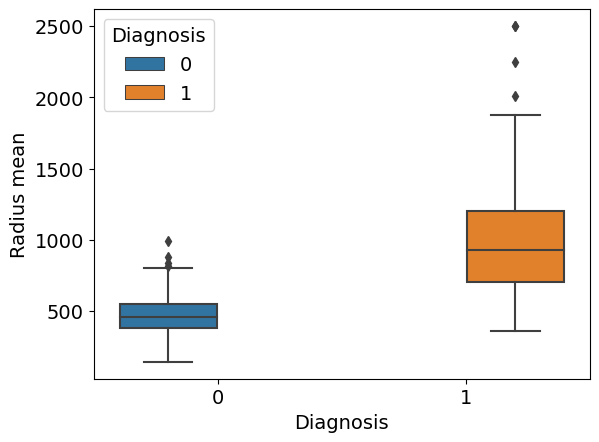

In [18]:
# Plot boxplot
p = sns.boxplot(data=cancerData, x="Diagnosis", y="Area mean", hue="Diagnosis")
p.set_xlabel("Diagnosis", fontsize=14)
p.set_ylabel("Radius mean", fontsize=14)
plt.show()

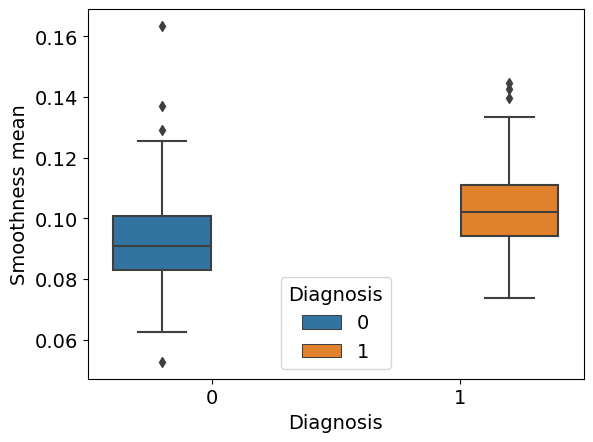

In [19]:
# Plot boxplot
p = sns.boxplot(data=cancerData, x="Diagnosis", y="Smoothness mean", hue="Diagnosis")
p.set_xlabel("Diagnosis", fontsize=14)
p.set_ylabel("Smoothness mean", fontsize=14)
plt.show()

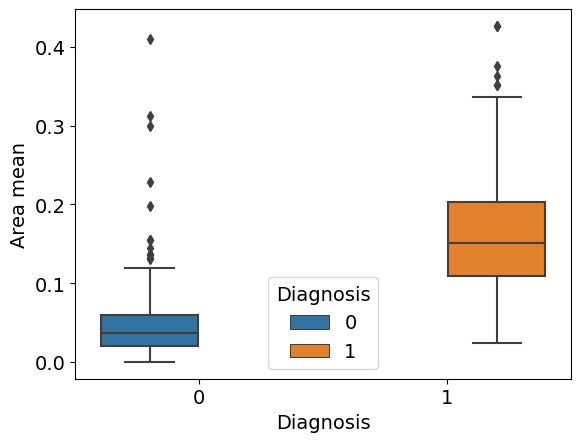

In [20]:
# Plot boxplot
p = sns.boxplot(data=cancerData, x='Diagnosis', y='Concavity mean', hue='Diagnosis')
p.set_xlabel('Diagnosis', fontsize=14)
p.set_ylabel('Area mean', fontsize=14)
plt.show()

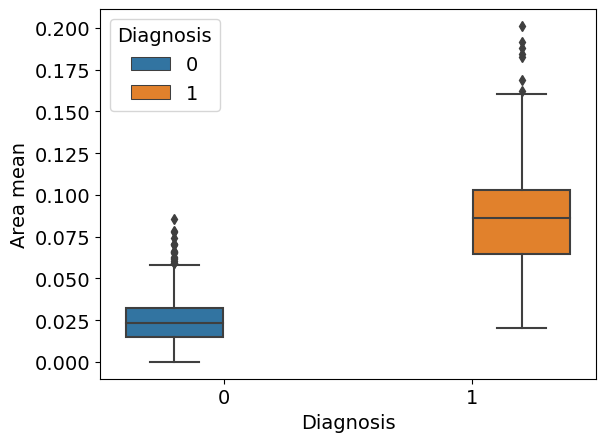

In [21]:
# Plot boxplot
p = sns.boxplot(data=cancerData, x='Diagnosis', y='Concave points mean', hue='Diagnosis')
p.set_xlabel('Diagnosis', fontsize=14)
p.set_ylabel('Area mean', fontsize=14)
plt.show()

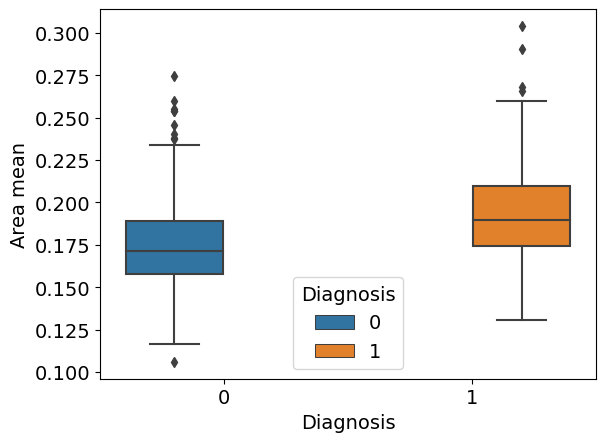

In [22]:
# Plot boxplot
p = sns.boxplot(data=cancerData, x='Diagnosis', y='Symmetry mean', hue='Diagnosis')
p.set_xlabel('Diagnosis', fontsize=14)
p.set_ylabel('Area mean', fontsize=14)
plt.show()

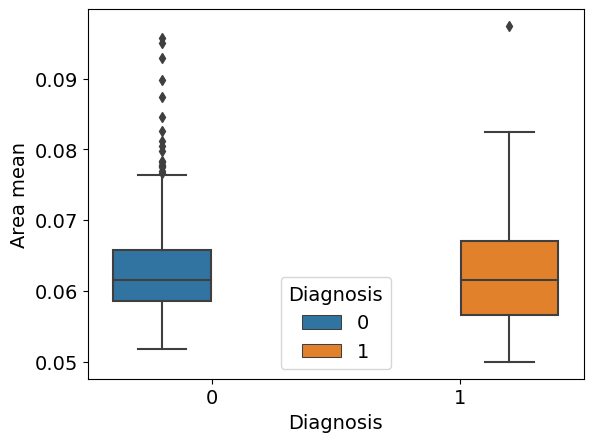

In [23]:
# Plot boxplot
p = sns.boxplot(data=cancerData, x='Diagnosis', y='Fractal dimension mean', hue='Diagnosis')
p.set_xlabel('Diagnosis', fontsize=14)
p.set_ylabel('Area mean', fontsize=14)
plt.show()

## k-nearest neighbors

In [24]:
seed = 123

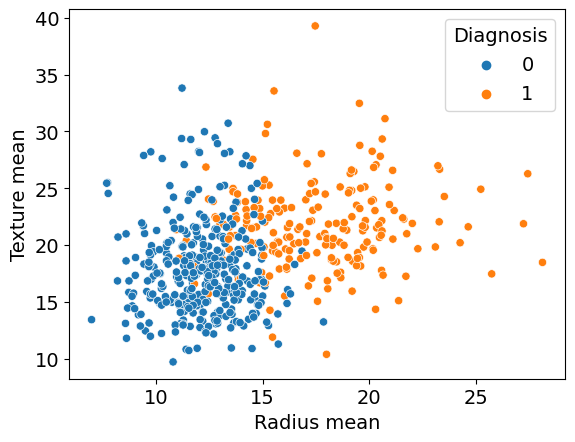

In [25]:
# Visual exploration
p = sns.scatterplot(data=cancerData, x='Radius mean', y='Texture mean', hue='Diagnosis')
p.set_xlabel('Radius mean', fontsize=14)
p.set_ylabel('Texture mean', fontsize=14)
plt.show()

In [26]:
# Define input and output features
X = cancerData[['Radius mean', 'Texture mean']]
y = cancerData[['Diagnosis']]

# Create training and testing data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=seed
)

# Scale the input features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [27]:
# Fit k-nearest neighbors with k=3
knn3 = KNeighborsClassifier(n_neighbors=3)
knn3.fit(X_train_scaled, np.ravel(y_train))

KNeighborsClassifier(n_neighbors=3)

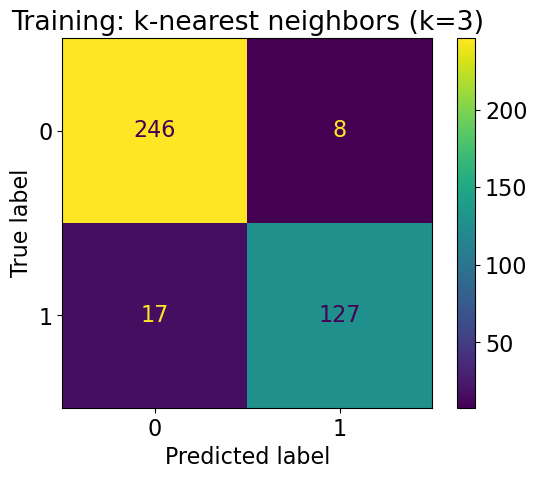

In [28]:
# Confusion matrix
y_pred = knn3.predict(X_train_scaled)

plt.rcParams.update({'font.size': 16})
cmTrain = confusion_matrix(y_train, y_pred)
cmTrain_plot = ConfusionMatrixDisplay(
    confusion_matrix=cmTrain, display_labels=knn3.classes_
)
cmTrain_plot.plot()
cmTrain_plot.ax_.set_title("Training: k-nearest neighbors (k=3)")
plt.show()

In [29]:
# Calculate accuracy, precision, and recall
accuracy = accuracy_score(y_train, y_pred)
precision = precision_score(y_train, y_pred)
recall = recall_score(y_train, y_pred)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)

Accuracy: 0.9371859296482412
Precision: 0.9407407407407408
Recall: 0.8819444444444444


In [30]:
# Fit k-nearest neighbors with k=7
knn7 = KNeighborsClassifier(n_neighbors=7)
knn7.fit(X_train_scaled, np.ravel(y_train))

KNeighborsClassifier(n_neighbors=7)

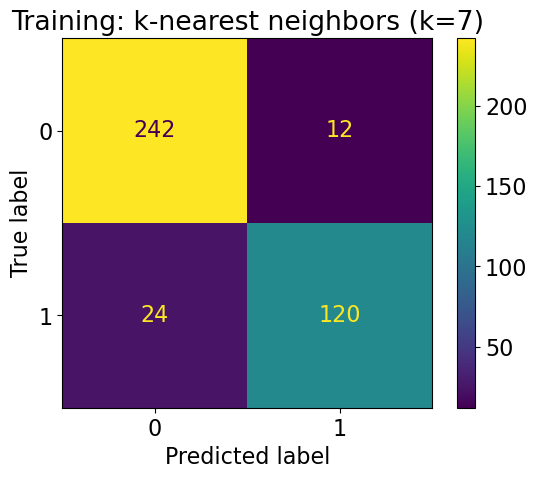

In [31]:
# Confusion matrix
y_pred = knn7.predict(X_train_scaled)

plt.rcParams.update({'font.size': 16})
cmTrain = confusion_matrix(y_train, y_pred)
cmTrain_plot = ConfusionMatrixDisplay(
    confusion_matrix=cmTrain, display_labels=knn7.classes_
)
cmTrain_plot.plot()
cmTrain_plot.ax_.set_title("Training: k-nearest neighbors (k=7)")
plt.show()

In [32]:
# Calculate accuracy, precision, and recall
accuracy = accuracy_score(y_train, y_pred)
precision = precision_score(y_train, y_pred)
recall = recall_score(y_train, y_pred)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)

Accuracy: 0.9095477386934674
Precision: 0.9090909090909091
Recall: 0.8333333333333334


In [33]:
# Fit k-nearest neighbors with k=11
knn11 = KNeighborsClassifier(n_neighbors=11)
knn11.fit(X_train_scaled, np.ravel(y_train))

KNeighborsClassifier(n_neighbors=11)

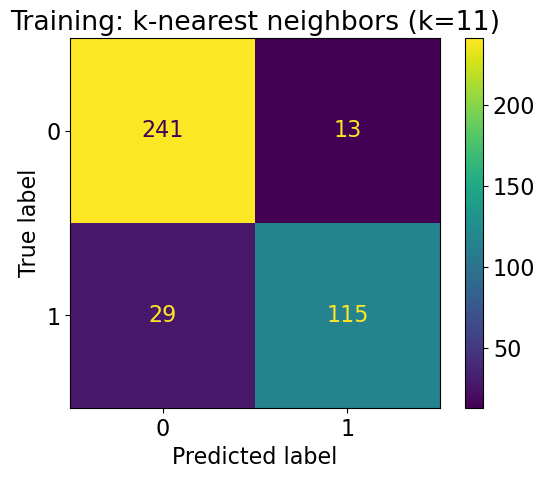

In [34]:
# Confusion matrix
y_pred = knn11.predict(X_train_scaled)

plt.rcParams.update({'font.size': 16})
cmTrain = confusion_matrix(y_train, y_pred)
cmTrain_plot = ConfusionMatrixDisplay(
    confusion_matrix=cmTrain, display_labels=knn11.classes_
)
cmTrain_plot.plot()
cmTrain_plot.ax_.set_title("Training: k-nearest neighbors (k=11)")
plt.show()

In [35]:
# Calculate accuracy, precision, and recall
accuracy = accuracy_score(y_train, y_pred)
precision = precision_score(y_train, y_pred)
recall = recall_score(y_train, y_pred)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)

Accuracy: 0.8944723618090452
Precision: 0.8984375
Recall: 0.7986111111111112


## Support vector classification based on radius and texture

In [36]:
seed2=123

In [37]:
# Define input and output features
X = cancerData[['Radius mean', 'Texture mean']]
y = cancerData[['Diagnosis']]

# Create training and testing data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=seed2
)

# Scale the input features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [38]:
# Fit SVM
linearSVM = svm.SVC(kernel='linear')
linearSVM.fit(X_train_scaled, y_train)

/Users/srisairesu/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


SVC(kernel='linear')

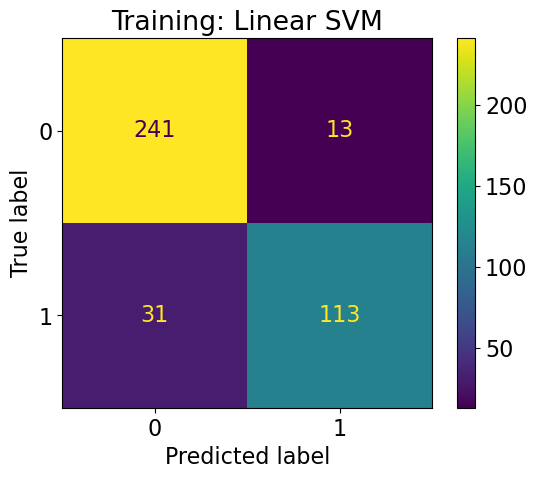

In [39]:
# Confusion matrix
y_pred = linearSVM.predict(X_train_scaled)
cmTrain = confusion_matrix(y_train, y_pred)

plt.rcParams.update({'font.size': 16})
cmTrain_plot = ConfusionMatrixDisplay(
    confusion_matrix=cmTrain, display_labels=linearSVM.classes_
)
cmTrain_plot.plot()
cmTrain_plot.ax_.set_title("Training: Linear SVM")
plt.show()

In [40]:
# Fit SVM
rbfSVM = svm.SVC(kernel='rbf')
rbfSVM.fit(X_train_scaled, y_train)

/Users/srisairesu/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


SVC()

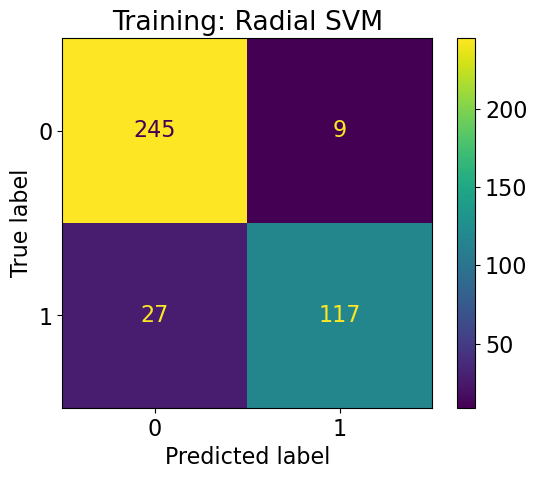

In [41]:
# Confusion matrix
y_pred = rbfSVM.predict(X_train_scaled)
cmTrain = confusion_matrix(y_train, y_pred)

plt.rcParams.update({'font.size': 16})
cmTrain_plot = ConfusionMatrixDisplay(
    confusion_matrix=cmTrain, display_labels=rbfSVM.classes_
)
cmTrain_plot.plot()
cmTrain_plot.ax_.set_title("Training: Radial SVM")
plt.show()

In [42]:
# Fit SVM
polySVM = svm.SVC(kernel='poly')
polySVM.fit(X_train_scaled, y_train)

/Users/srisairesu/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


SVC(kernel='poly')

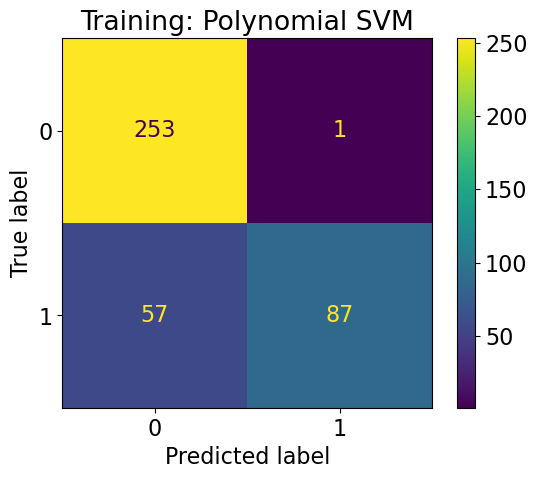

In [43]:
# Confusion matrix
y_pred = polySVM.predict(X_train_scaled)
cmTrain = confusion_matrix(y_train, y_pred)

plt.rcParams.update({'font.size': 16})
cmTrain_plot = ConfusionMatrixDisplay(
    confusion_matrix=cmTrain, display_labels=polySVM.classes_
)
cmTrain_plot.plot()
cmTrain_plot.ax_.set_title("Training: Polynomial SVM")
plt.show()

## Comparing classification models

In [44]:
# Define input and output features
# Remove ID and diagnosis from X
X = cancerData.iloc[:, 2:33]
y = cancerData[['Diagnosis']]

# Create training and testing data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=seed
)

# Scale the input features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [45]:
y_train.describe()

,Diagnosis
count,398.000000
mean,0.361809
std,0.481129
min,0.000000
25%,0.000000
50%,0.000000
75%,1.000000
max,1.000000


In [46]:
y_test.describe()

,Diagnosis
count,171.000000
mean,0.397661
std,0.490852
min,0.000000
25%,0.000000
50%,0.000000
75%,1.000000
max,1.000000


In [47]:
# Fit k-nearest neighbors with k=3
knn3 = KNeighborsClassifier(n_neighbors=3)
knn3.fit(X_train_scaled, np.ravel(y_train))

# Fit k-nearest neighbors with k=7
knn7 = KNeighborsClassifier(n_neighbors=7)
knn7.fit(X_train_scaled, np.ravel(y_train))

# Fit k-nearest neighbors with k=11
knn11 = KNeighborsClassifier(n_neighbors=11)
knn11.fit(X_train_scaled, np.ravel(y_train))

# Fit linear support vector classifier
linearSVM = svm.SVC(kernel='linear')
linearSVM.fit(X_train_scaled, y_train)

# Fit radial support vector classifier
rbfSVM = svm.SVC(kernel='rbf')
rbfSVM.fit(X_train_scaled, y_train)

# Fit polynomial support vector classifier
polySVM = svm.SVC(kernel='poly')
polySVM.fit(X_train_scaled, y_train)

/Users/srisairesu/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/srisairesu/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/srisairesu/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


SVC(kernel='poly')

In [48]:
# Calculate scores on training for all models
train_scores = [
    knn3.score(X_train_scaled, y_train),
    knn7.score(X_train_scaled, y_train),
    knn11.score(X_train_scaled, y_train),
    linearSVM.score(X_train_scaled, y_train),
    rbfSVM.score(X_train_scaled, y_train),
    polySVM.score(X_train_scaled, y_train),
]

train_scores

[0.9798994974874372,
 0.9673366834170855,
 0.964824120603015,
 0.9874371859296482,
 0.9824120603015075,
 0.9120603015075377]

/Users/srisairesu/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


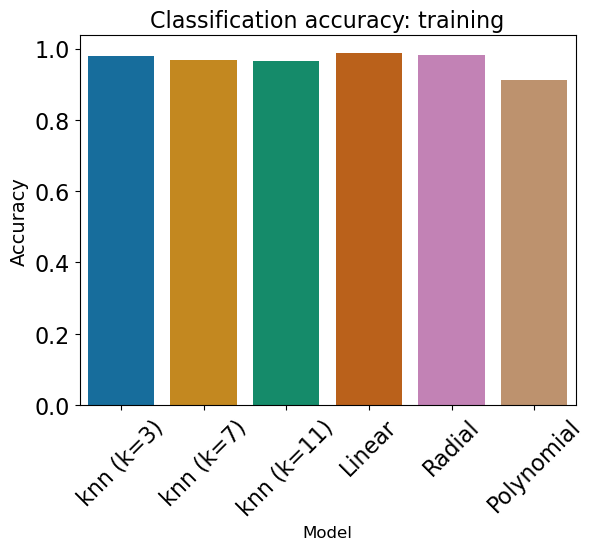

In [49]:
# Plot scores on training for all models
model = ['knn (k=3)', 'knn (k=7)', 'knn (k=11)', 'Linear', 'Radial', 'Polynomial']

p = sns.barplot(x=model, y=train_scores, palette='colorblind')
p.set_xlabel('Model', fontsize=12)
plt.xticks(rotation=45)
p.set_ylabel('Accuracy', fontsize=14)
p.set_title('Classification accuracy: training', fontsize=16)
plt.show()

In [50]:
# Calculate scores on testing for all models
test_scores = [
    knn3.score(X_test_scaled, y_test),
    knn7.score(X_test_scaled, y_test),
    knn11.score(X_test_scaled, y_test),
    linearSVM.score(X_test_scaled, y_test),
    rbfSVM.score(X_test_scaled, y_test),
    polySVM.score(X_test_scaled, y_test),
]

test_scores

[0.9883040935672515,
 0.9766081871345029,
 0.9824561403508771,
 0.9883040935672515,
 0.9824561403508771,
 0.8771929824561403]

/Users/srisairesu/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


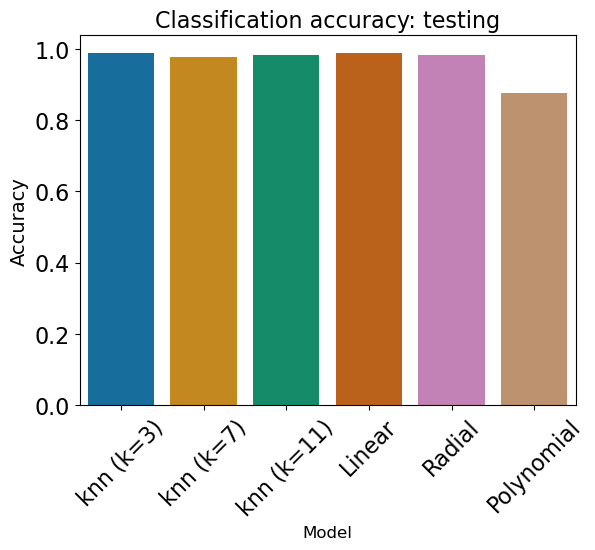

In [51]:
# Plot scores on testing for all models
p = sns.barplot(x=model, y=test_scores, palette='colorblind')
p.set_xlabel('Model', fontsize=12)
plt.xticks(rotation=45)
p.set_ylabel('Accuracy', fontsize=14)
p.set_title('Classification accuracy: testing', fontsize=16)
plt.show()

/Users/srisairesu/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


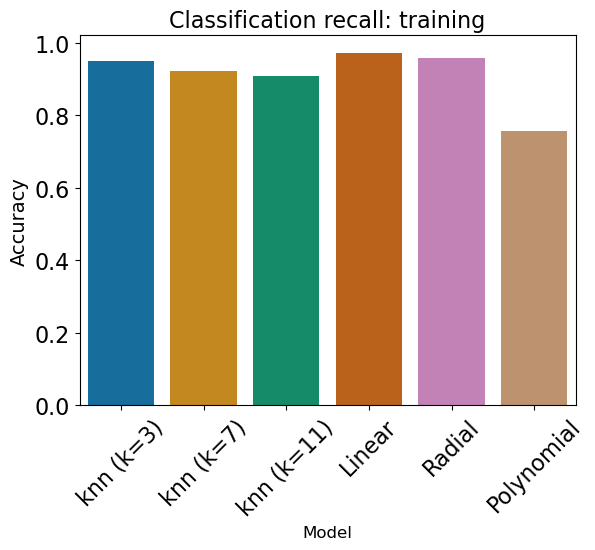

In [52]:
# Calculate recall on training for all models
train_recall = [
    recall_score(y_train, knn3.predict(X_train_scaled)),
    recall_score(y_train, knn7.predict(X_train_scaled)),
    recall_score(y_train, knn11.predict(X_train_scaled)),
    recall_score(y_train, linearSVM.predict(X_train_scaled)),
    recall_score(y_train, rbfSVM.predict(X_train_scaled)),
    recall_score(y_train, polySVM.predict(X_train_scaled)),
]

p = sns.barplot(x=model, y=train_recall, palette='colorblind')
p.set_xlabel('Model', fontsize=12)
plt.xticks(rotation=45)
p.set_ylabel('Accuracy', fontsize=14)
p.set_title('Classification recall: training', fontsize=16)
plt.show()

/Users/srisairesu/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


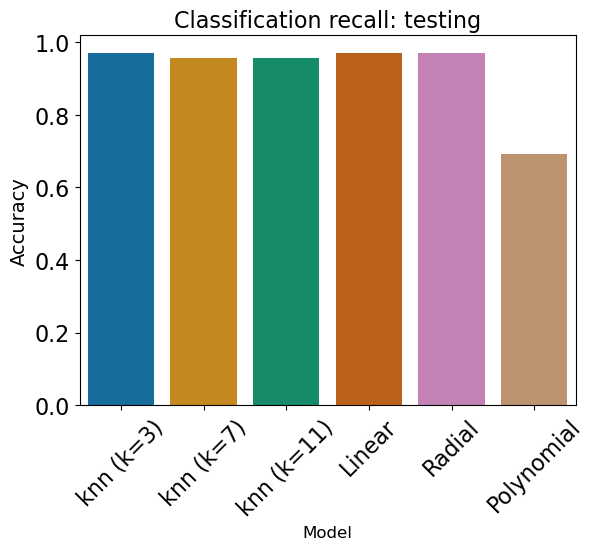

In [53]:
# Calculate recall on testing for all models
test_recall = [
    recall_score(y_test, knn3.predict(X_test_scaled)),
    recall_score(y_test, knn7.predict(X_test_scaled)),
    recall_score(y_test, knn11.predict(X_test_scaled)),
    recall_score(y_test, linearSVM.predict(X_test_scaled)),
    recall_score(y_test, rbfSVM.predict(X_test_scaled)),
    recall_score(y_test, polySVM.predict(X_test_scaled)),
]

p = sns.barplot(x=model, y=test_recall, palette='colorblind')
p.set_xlabel('Model', fontsize=12)
plt.xticks(rotation=45)
p.set_ylabel('Accuracy', fontsize=14)
p.set_title('Classification recall: testing', fontsize=16)
plt.show()

In [54]:
test_recall

[0.9705882352941176,
 0.9558823529411765,
 0.9558823529411765,
 0.9705882352941176,
 0.9705882352941176,
 0.6911764705882353]

## Logistic Regression

In [55]:
# Store relevant columns as variables
X = cancerData[['Radius mean']].values.reshape(-1, 1)
y = cancerData[['Diagnosis']].values.reshape(-1, 1).astype(int)

Text(0, 0.5, 'Probability of malignant tumor')

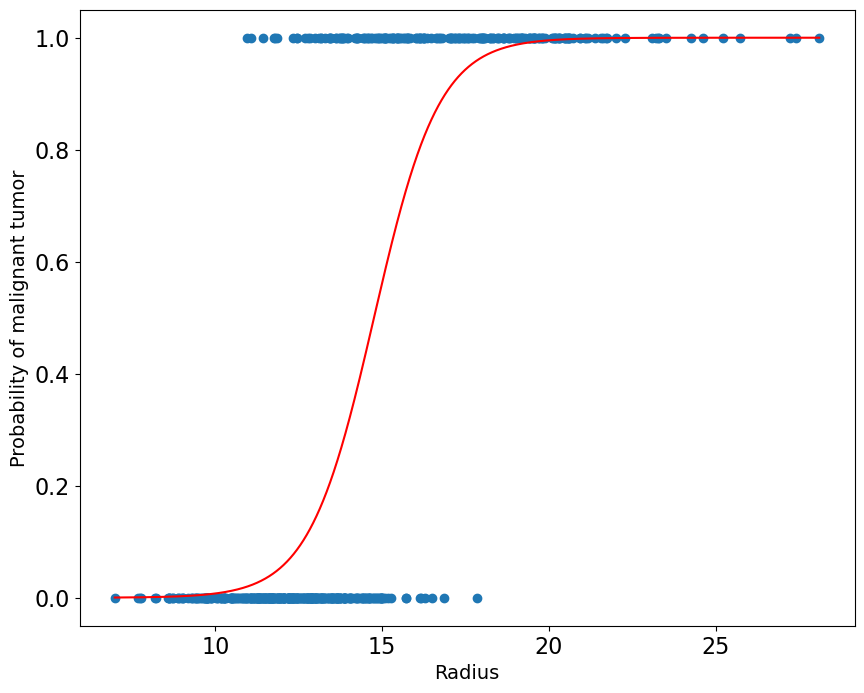

In [56]:
# Logistic regression predicting diagnosis from tumor radius
logisticModel = LogisticRegression()
logisticModel.fit(X, np.ravel(y.astype(int)))

# Graph logistic regression probabilities
plt.figure(figsize=(10, 8)) 
plt.scatter(X, y)
xDelta = np.linspace(X.min(), X.max(), 10000)
yPredicted = logisticModel.predict(X).reshape(-1, 1).astype(int)
yDeltaProb = logisticModel.predict_proba(xDelta.reshape(-1, 1))[:, 1]
plt.plot(xDelta, yDeltaProb, color='red')
plt.xlabel('Radius', fontsize=14)
plt.ylabel('Probability of malignant tumor', fontsize=14)

In [57]:
# Display the slope parameter estimate
logisticModel.coef_

array([[1.02475609]])

In [58]:
# Display the intercept parameter estimate
logisticModel.intercept_

array([-15.120902])

In [59]:
# Predict the probability a tumor with radius mean 13 is benign / malignant
pHatProb = logisticModel.predict_proba([[13]])
pHatProb[0]

array([0.85803604, 0.14196396])

In [60]:
# Classify whether tumor with radius mean 13 is benign (0) or malignant (1)
pHat = logisticModel.predict([[13]])
pHat[0]

0

In [61]:
print(
    "A tumor with radius mean 13 has predicted probability: \n",
    pHatProb[0][0],
    "of being benign\n",
    pHatProb[0][1],
    "of being malignant\n",
    "and overall is classified to be benign",
)

A tumor with radius mean 13 has predicted probability: 
 0.8580360397250095 of being benign
 0.14196396027499042 of being malignant
 and overall is classified to be benign


## Decision Trees

## Decision tree with depth=2

In [62]:
seed = 123

In [63]:
# Define input and output features  ### refer 11.5
X = marijuana[['age', 'educ', 'polviews_num']]
y = marijuana[['marijuana01']]

NameError: name 'marijuana' is not defined